# Applying lake drainage calculations across snippets from other seasons

In [1]:
# Load libraries
import sys
import sys
sys.path.append("../../../xapres_package/")
import ApRESDefs
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker 
import pickle

import xarray as xr
import importlib
import pandas as pd
import math
from datetime import datetime, timedelta, date
from scipy.stats import linregress
from helpers import *

importlib.reload(ApRESDefs)
xa = ApRESDefs.xapres(loglevel='debug')

DEBUG    18:04:49 	 ApRESDefs.py @function _setup_logging line 615 - Stream logging level set to DEBUG
DEBUG    18:04:49 	 ApRESDefs.py @function _setup_logging line 616 - Add console handler to logger
DEBUG    18:04:49 	 ApRESDefs.py @function _setup_logging line 629 - File logging level set to DEBUG


In [2]:
# Load data
ds_11 = reload("A101")
ds_11 = ds_11.isel(time=range(20,len(ds_11.time))) # trim first few bursts, which were tests

ds_13 = reload("A103_fixed")
ds_13 = ds_13.isel(time=range(60,len(ds_13.time))) # trim first few bursts, which were tests

ds_14 = reload("A104")
ds_14 = ds_14.isel(time=range(50,len(ds_14.time))) # trim first few bursts, which were tests



In [3]:
# helper functions
def shift_profile_range(profiles,shift_value):
    profiles_adjust = profiles.where(profiles.profile_range > shift_value, drop = True)
    profiles_adjust['profile_range'] = profiles_adjust.profile_range - shift_value
    return profiles_adjust

def strain_metrics(ds, win_cor, step, lag, noise_floor,bin_adjust=1):
    # This function, given a window, and step, gives a total percentage of data that has high coherence
    b1 = ds.isel(time=range(0,len(ds)-lag))
    b2 = ds.isel(time=range(lag,len(ds)))
    dz, co, phi = xa.generate_range_diff(b1,b2,win_cor,step,None,0,0.95)
    dz=dz.assign(coherence=(['time','profile_range'],co))
    dz_new = dz.where(abs(dz.coherence) > 0.95).drop_duplicates('time')

    vv = dz_new.range_diff / dz_new.time_diff * 31536000
    vv_adjust = vv - vv.isel(profile_range = range(0,bin_adjust)).mean(dim='profile_range')
    vv_err = dz_new.err / dz_new.time_diff * 31536000
    vv_mean_err = (vv_err.isel(profile_range = range(0,bin_adjust))**2).sum(dim='profile_range')/bin_adjust
    vv_adjust_err = np.sqrt(vv_err**2 + vv_mean_err)

    #fit=vv.where(vv.profile_range <=noise_floor).polyfit('profile_range',1,full=True)
    fit=vv.where(vv.profile_range <=noise_floor).polyfit('profile_range',1,full=True)
    r2 = 1-fit.polyfit_residuals/((vv.where(vv.profile_range <=noise_floor)-vv.where(vv.profile_range <=noise_floor).mean())**2).sum(dim='profile_range')
    
    slope = fit.polyfit_coefficients.sel(degree=1)*vv.profile_range+fit.polyfit_coefficients.sel(degree=0)
    residual = vv-slope
    residual = residual.where(residual.profile_range <=noise_floor,drop=True)
    slope_errs = np.sqrt((1/(len(residual.profile_range)-2))*(((residual**2).sum(dim='profile_range'))/((residual.profile_range - residual.profile_range.mean())**2).sum()))

    int_err = slope_errs*np.sqrt(((vv.profile_range)**2).sum()/len(vv.profile_range))
    ds = vv.to_dataset(name='vv')
    ds['err'] = vv_err
    ds['slope']= fit.polyfit_coefficients.sel(degree=1)
    ds['intercept']=fit.polyfit_coefficients.sel(degree=0)
    ds['fit'] = slope
    ds['slope_err'] = slope_errs
    ds['int_err'] = int_err
    ds['vv_adjust'] = vv_adjust
    ds['vv_adjust_err'] = vv_adjust_err
    ds['doy_decimal'] =  ds.time.dt.dayofyear + (ds.time.dt.hour / 24) + (ds.time.dt.minute / 1440) + (ds.time.dt.second / 86400)
    return ds
    
def plot_fits(ds_array,label_array,doy=False):
    fig, axs = plt.subplots(nrows=1,figsize=(15,6),sharex=True)
    for i in range(len(ds_array)):
        ds = ds_array[i]
        if doy:
            axs.errorbar(ds.doy_decimal,ds.slope,yerr=ds.slope_err,marker='.',label = label_array[i])
            axs.set_xlabel('DOY')
        else:
            axs.errorbar(ds.time.values,ds.slope,yerr=ds.slope_err,marker='.',label = label_array[i])
    axs.legend()
    axs.set_ylabel('Strain rate [y$^{-1}$]')
    axs.set_title('Strain rate estimates')
    
    

def convert_to_doy(da):
    da['doy_decimal'] = da.time.dt.dayofyear + (da.time.dt.hour / 24) + (da.time.dt.minute / 1440) + (da.time.dt.second / 86400)
    return da

def animate_vv(vv):
    # ok it looks like the oscillations are due to a fitting  artifact
    import matplotlib.pyplot as plt
    import matplotlib.animation
    import numpy as np
    
    
    fig,axs = plt.subplots(figsize=(15, 10),nrows = 2)
    
    
    times = vv.doy_decimal.values
    strain = axs[0].errorbar(vv.doy_decimal,vv.slope,yerr=vv.slope_err,marker='.')
    
    #ax4.set_yscale('symlog', linthresh=0.1)
    axs[0].set_xlabel('DOY 2022')
    axs[0].set_ylabel('strain rate [y$^{-1}$]')
    time_line = axs[0].axvline(times[0],color = 'black',linestyle = '--')
    title_str = str(vv.time.values[0])[:16].replace('T',' ')
    axs[0].set_title(f'Time = {title_str}')
    
    
    axs[1].errorbar(vv.profile_range,vv.vv.isel(time=0),yerr=vv.err.isel(time=0),linestyle='None',marker='.',color = 'tab:blue')
    axs[1].plot(vv.profile_range.where(vv.profile_range<600),vv.fit.isel(time=0).where(vv.profile_range<600),color='k')
    axs[1].set_ylim([-10,10])
    
    def animate(i):
        i = 10*i
        time_line.set_xdata([times[i],times[i]])
        title_str = str(vv.time.values[i])[:16].replace('T',' ')
        axs[0].set_title(f'Time = {title_str}')
        
        axs[1].clear()
        axs[1].errorbar(vv.profile_range,vv.vv.isel(time=i),yerr=vv.err.isel(time=i),linestyle='None',marker='.',color = 'tab:blue')
        axs[1].plot(vv.profile_range.where(vv.profile_range<600),vv.fit.isel(time=i).where(vv.profile_range<600),color='k')
    
        #axs[1].set_ylim([-10,10])
    
    
      
    
    ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(times)//10)
    
    return ani


## A11

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


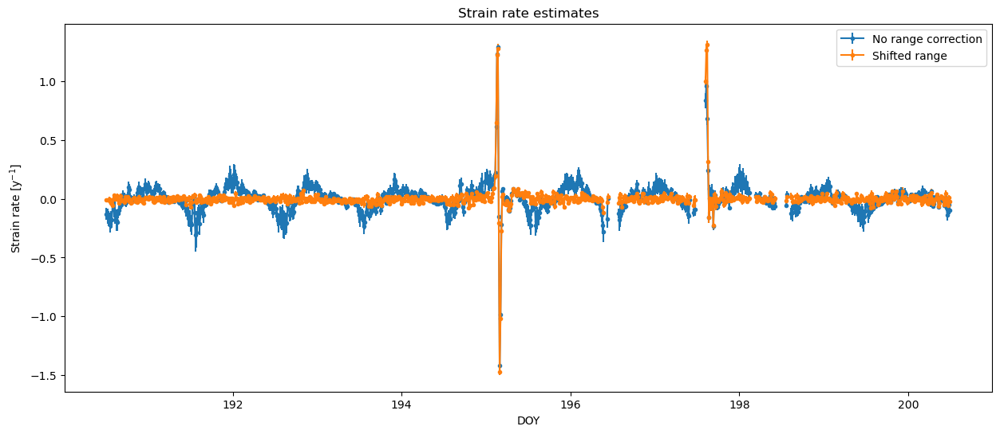

In [4]:
# A11 lake drainage
ds_11_drain = ds_11.isel(time=range(4200,5200))
test = custom_profile(ds_11_drain.isel(attenuator_setting_pair=0).chirp,clip_threshold=1.2,min_chirps = 5,start=20000)
time_to_interp = pd.date_range("2022-07-09 12:00", "2022-07-19 12:00", freq="15min")
interp_profiles = test.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

a11 = strain_metrics(interp_profiles, 50, 50,1,500)
a11_adjust = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
plot_fits([a11,a11_adjust],['No range correction','Shifted range'],doy=True)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.1, 0.1)

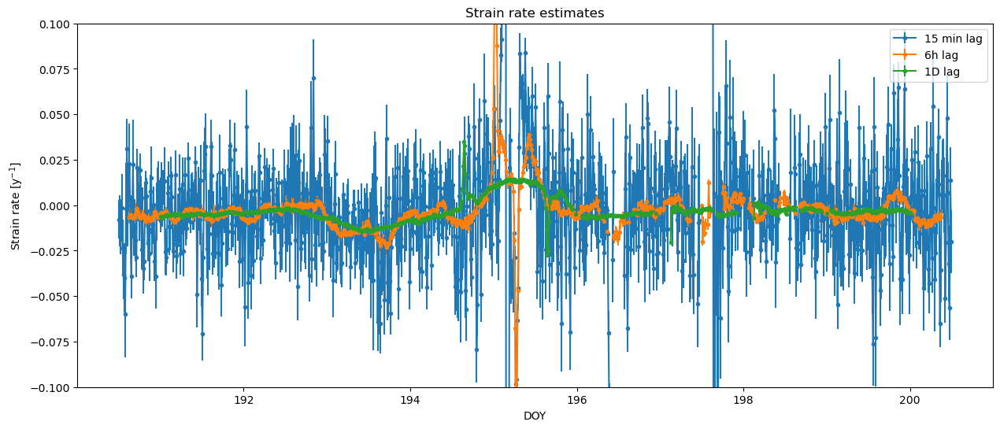

In [10]:
a11_15 = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
a11_6h = strain_metrics(interp_profiles_adjust, 50, 50,24,500,2)
a11_1d = strain_metrics(interp_profiles_adjust, 50, 50,96,500,2)


plot_fits([a11_15,a11_6h,a11_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.1,0.1])

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


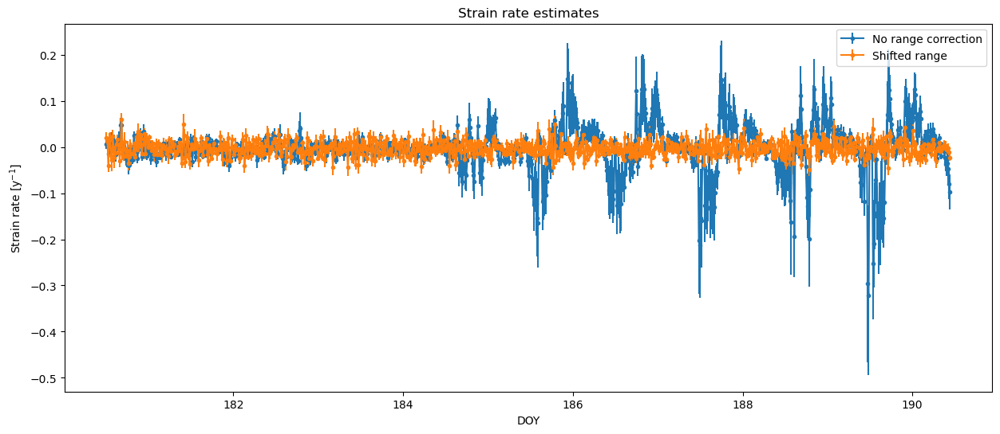

In [11]:
# immediately before
ds_11_drain = ds_11.isel(time=range(3200,4200))
test = custom_profile(ds_11_drain.isel(attenuator_setting_pair=0).chirp,clip_threshold=1.2,min_chirps = 5,start=20000)
time_to_interp = pd.date_range("2022-06-29 12:00", "2022-07-09 12:00", freq="15min")
interp_profiles = test.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

a11 = strain_metrics(interp_profiles, 50, 50,1,500)
a11_adjust = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
plot_fits([a11,a11_adjust],['No range correction','Shifted range'],doy=True)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.01, 0.01)

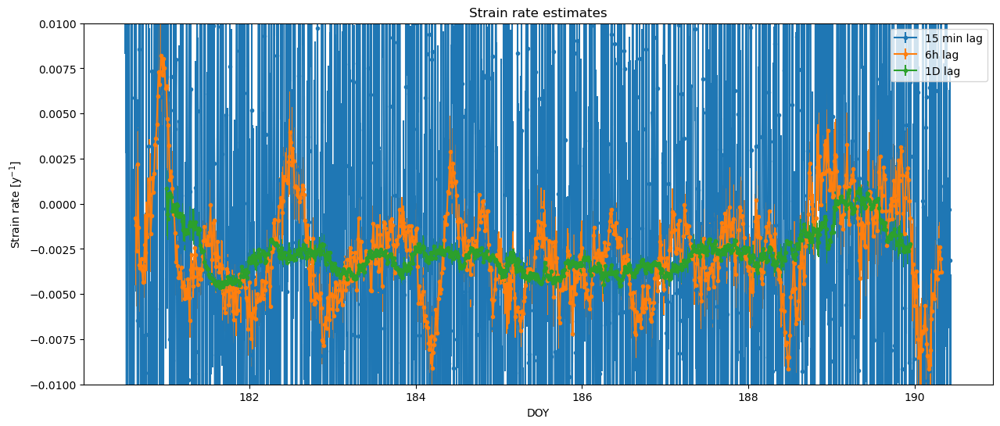

In [13]:
a11_15 = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
a11_6h = strain_metrics(interp_profiles_adjust, 50, 50,24,500,2)
a11_1d = strain_metrics(interp_profiles_adjust, 50, 50,96,500,2)


plot_fits([a11_15,a11_6h,a11_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.01,0.01])

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


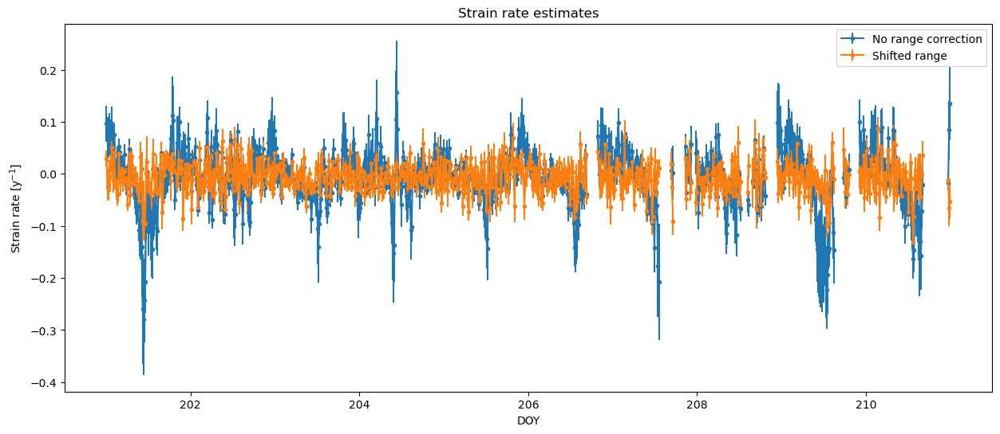

In [14]:
# immediately after
ds_11_drain = ds_11.isel(time=range(5200,6200))
test = custom_profile(ds_11_drain.isel(attenuator_setting_pair=0).chirp,clip_threshold=1.2,min_chirps = 5,start=20000)
time_to_interp = pd.date_range("2022-07-20 0:00", "2022-07-30 0:00", freq="15min")
interp_profiles = test.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

a11 = strain_metrics(interp_profiles, 50, 50,1,500)
a11_adjust = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
plot_fits([a11,a11_adjust],['No range correction','Shifted range'],doy=True)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.01, 0.01)

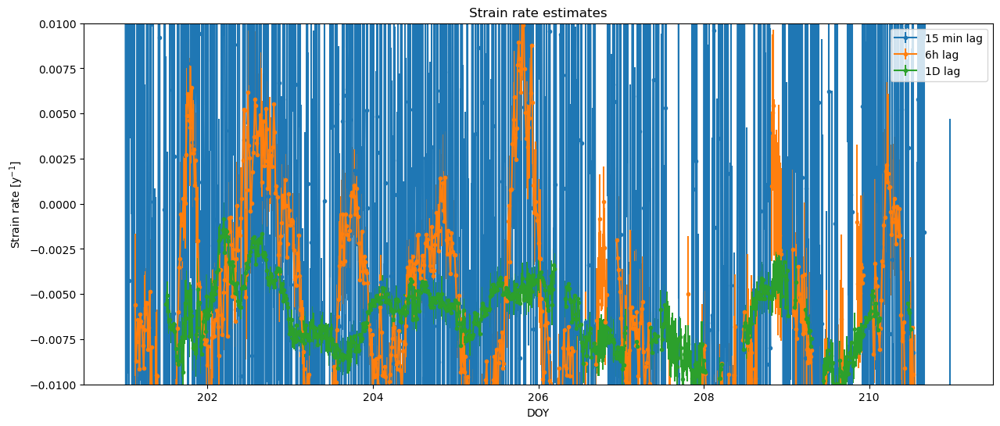

In [15]:
a11_15 = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
a11_6h = strain_metrics(interp_profiles_adjust, 50, 50,24,500,2)
a11_1d = strain_metrics(interp_profiles_adjust, 50, 50,96,500,2)


plot_fits([a11_15,a11_6h,a11_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.01,0.01])

In [2]:
# Load data
with open('../chirp_processing/A11_22S.pickle', 'rb') as handle:
    s22 = pickle.load(handle)

with open('../chirp_processing/A11_22W.pickle', 'rb') as handle:
    winter = pickle.load(handle)

NameError: name 'pickle' is not defined

In [1]:
# all summer
time_to_interp = pd.date_range("2022-05-27 12:00", "2022-09-25 12:00", freq="15min")
interp_profiles = s22.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

a11 = strain_metrics(interp_profiles, 50, 50,1,500)
a11_adjust = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
plot_fits([a11,a11_adjust],['No range correction','Shifted range'])
plt.xlim([240,245])

NameError: name 's22' is not defined

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.01, 0.01)

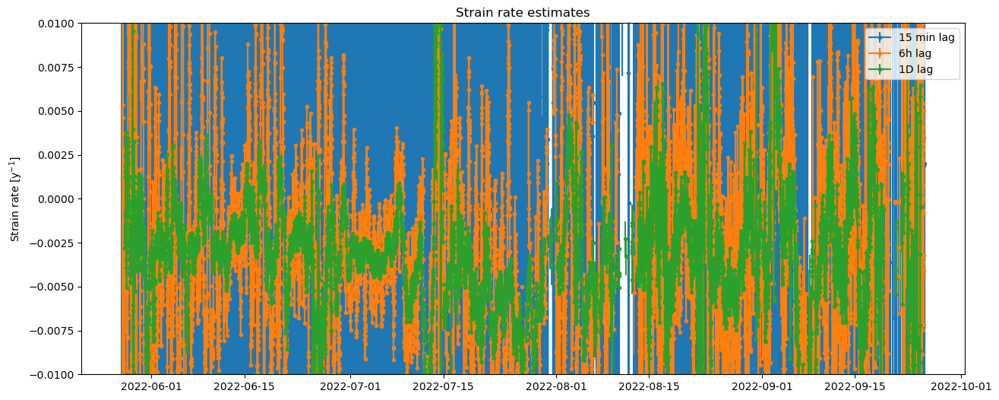

In [20]:
a11_15 = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
a11_6h = strain_metrics(interp_profiles_adjust, 50, 50,24,500,2)
a11_1d = strain_metrics(interp_profiles_adjust, 50, 50,96,500,2)


plot_fits([a11_15,a11_6h,a11_1d],['15 min lag','6h lag','1D lag'])
plt.ylim([-0.01,0.01])

(240.0, 245.0)

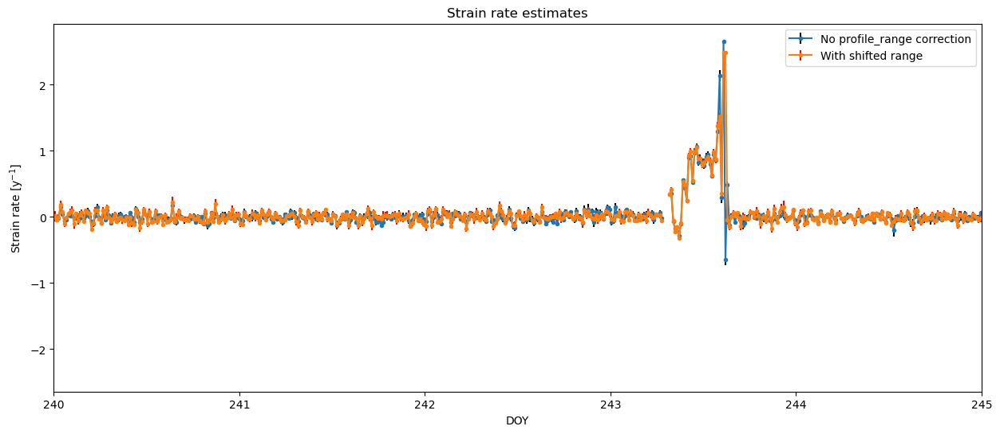

In [9]:
plot_fits(a11,a11_adjust,doy=True)
plt.xlim([240,245])

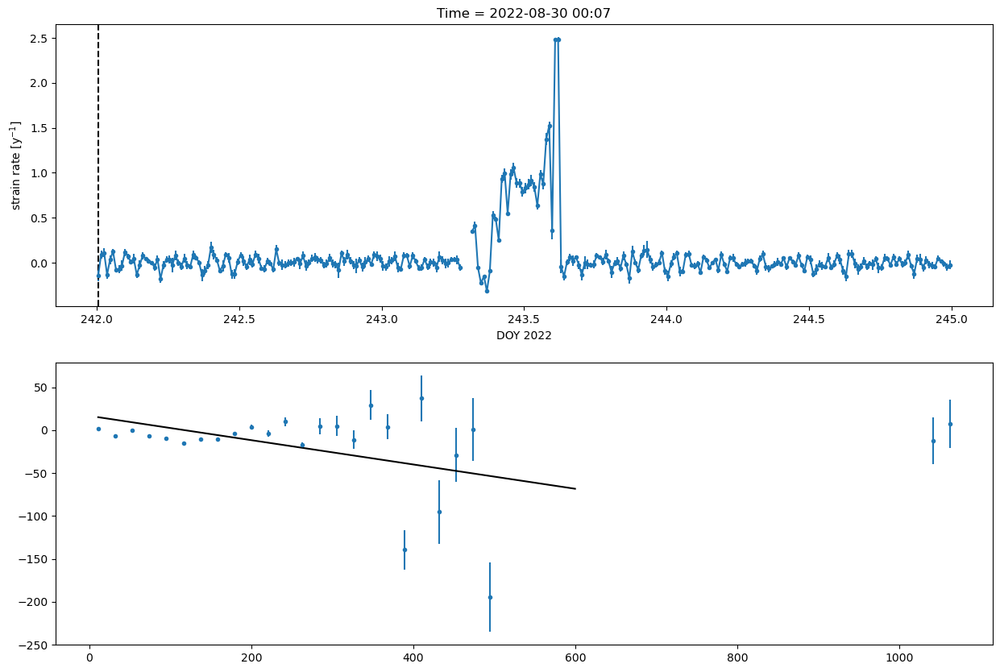

In [10]:
ani = animate_vv(a11_adjust.where(a11_adjust.doy_decimal > 242,drop = True).where(a11_adjust.doy_decimal < 245,drop=True))
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

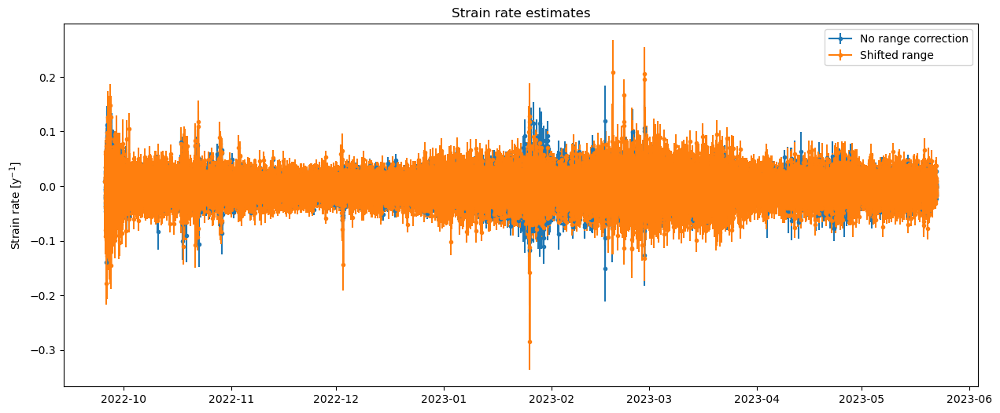

In [21]:
# all winter
time_to_interp = pd.date_range("2022-09-25 16:00", "2023-05-22 12:00", freq="15min")
interp_profiles = winter.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

a11 = strain_metrics(interp_profiles, 50, 50,1,500)
a11_adjust = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
plot_fits([a11,a11_adjust],['No range correction','Shifted range'])
#plt.xlim([240,245])

(-0.01, 0.01)

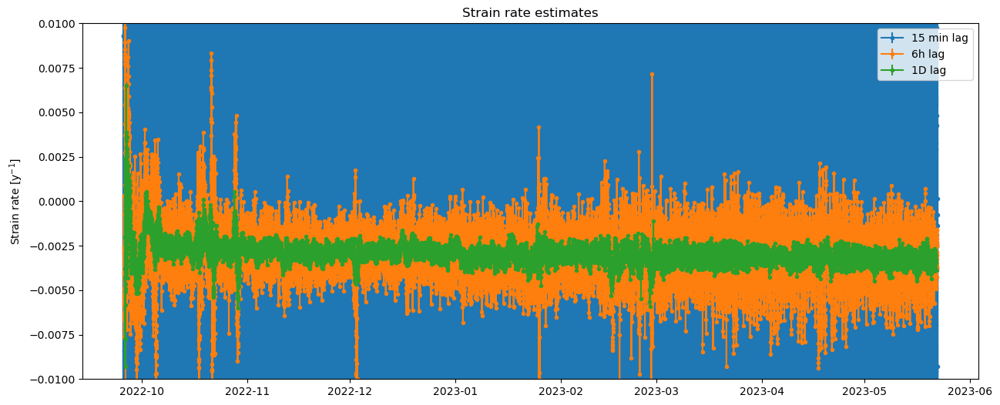

In [22]:
a11_15 = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
a11_6h = strain_metrics(interp_profiles_adjust, 50, 50,24,500,2)
a11_1d = strain_metrics(interp_profiles_adjust, 50, 50,96,500,2)


plot_fits([a11_15,a11_6h,a11_1d],['15 min lag','6h lag','1D lag'])
plt.ylim([-0.01,0.01])

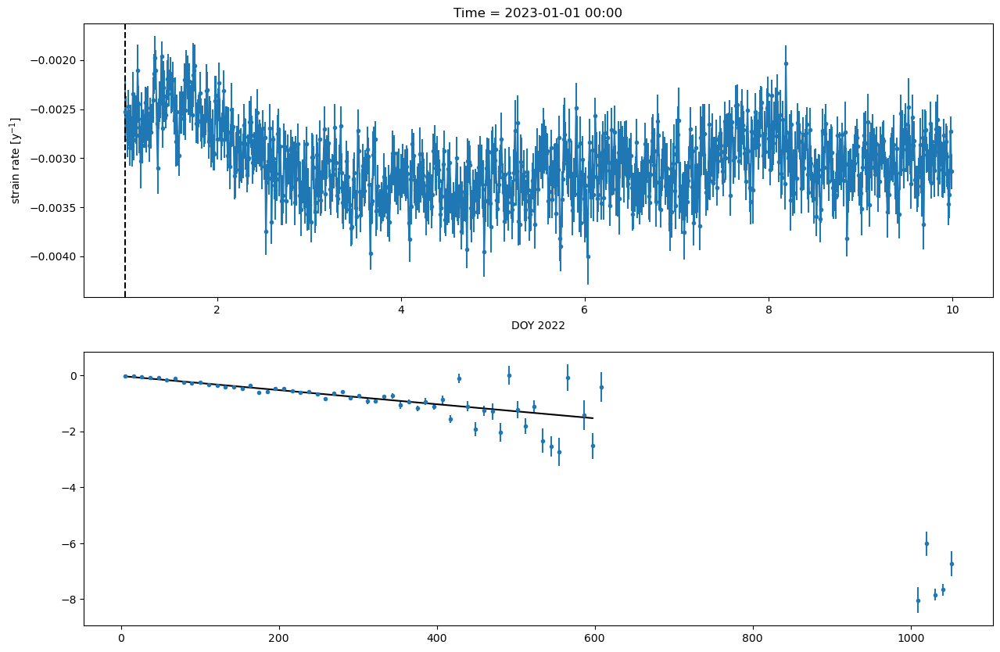

In [25]:
ani = animate_vv(a11_1d.where(a11_1d.doy_decimal > 0,drop = True).where(a11_1d.doy_decimal < 10,drop=True))
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

## A13

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


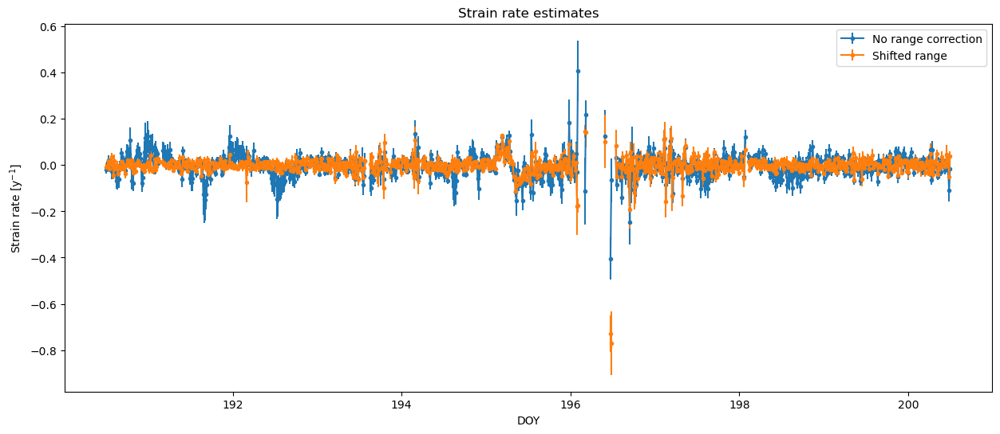

In [5]:
ds_13_drain = ds_13.isel(time=range(4200,5200))
test = custom_profile(ds_13_drain.isel(attenuator_setting_pair=0).chirp,clip_threshold=1.2,min_chirps = 5,start=30000)
time_to_interp = pd.date_range("2022-07-09 12:00", "2022-07-19 12:00", freq="15min")
interp_profiles = test.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,25)
a13 = strain_metrics(interp_profiles, 24, 24,1,500)
a13_adjust = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)

plot_fits([a13,a13_adjust],['No range correction','Shifted range'],doy=True)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.1, 0.1)

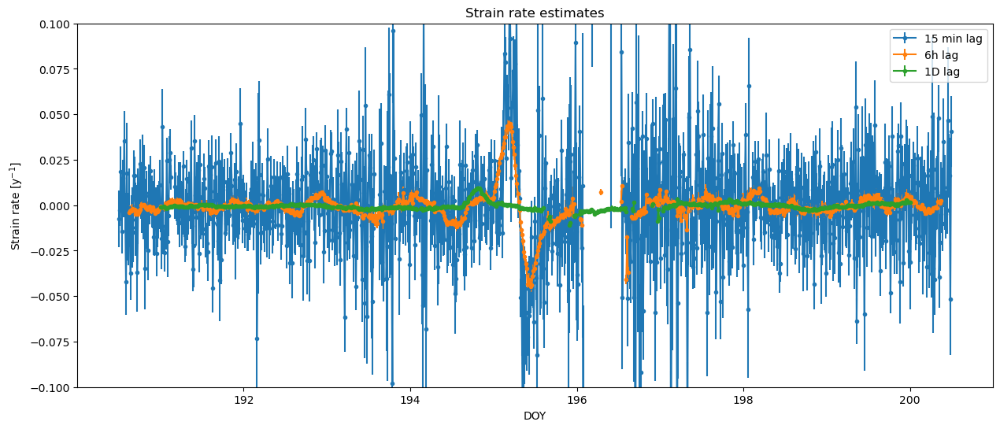

In [7]:
a13_15 = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
a13_6h = strain_metrics(interp_profiles_adjust, 24, 24,24,500,1)
a13_1d = strain_metrics(interp_profiles_adjust, 24, 24,96,500,1)


plot_fits([a13_15,a13_6h,a13_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.1,0.1])

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


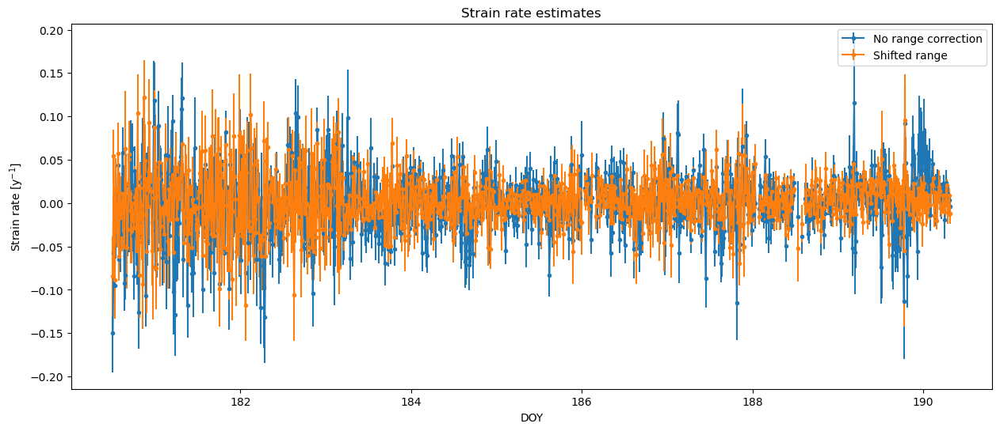

In [8]:
# before
ds_13_drain = ds_13.isel(time=range(3200,4200))
test = custom_profile(ds_13_drain.isel(attenuator_setting_pair=0).chirp,clip_threshold=1.2,min_chirps = 5,start=30000)
time_to_interp = pd.date_range("2022-06-29 12:00", "2022-07-09 12:00", freq="15min")
interp_profiles = test.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,25)
a13 = strain_metrics(interp_profiles, 24, 24,1,500)
a13_adjust = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
plot_fits([a13,a13_adjust],['No range correction','Shifted range'],doy=True)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.1, 0.1)

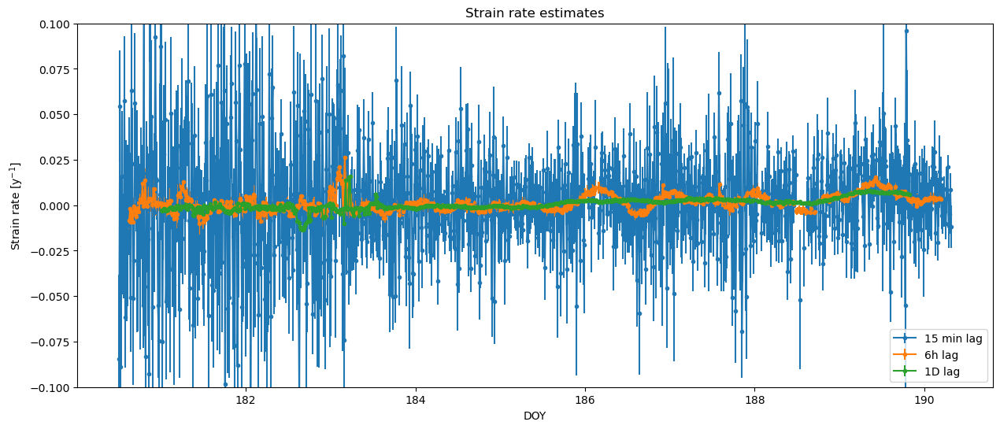

In [9]:
a13_15 = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
a13_6h = strain_metrics(interp_profiles_adjust, 24, 24,24,500,1)
a13_1d = strain_metrics(interp_profiles_adjust, 24, 24,96,500,1)


plot_fits([a13_15,a13_6h,a13_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.1,0.1])

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


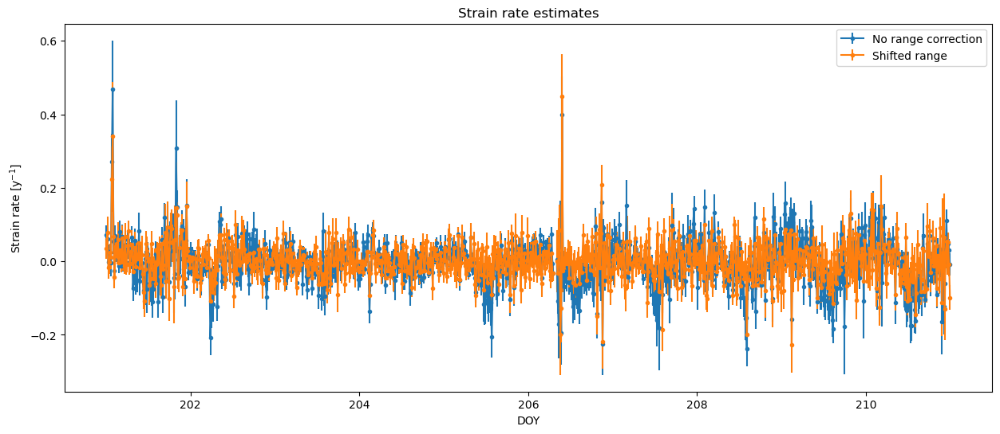

In [10]:
# after
ds_13_drain = ds_13.isel(time=range(5200,6200))
test = custom_profile(ds_13_drain.isel(attenuator_setting_pair=0).chirp,clip_threshold=1.2,min_chirps = 5,start=30000)
time_to_interp = pd.date_range("2022-07-20 0:00", "2022-07-30 0:00", freq="15min")
interp_profiles = test.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,25)
a13 = strain_metrics(interp_profiles, 24, 24,1,500)
a13_adjust = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
plot_fits([a13,a13_adjust],['No range correction','Shifted range'],doy=True)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.1, 0.1)

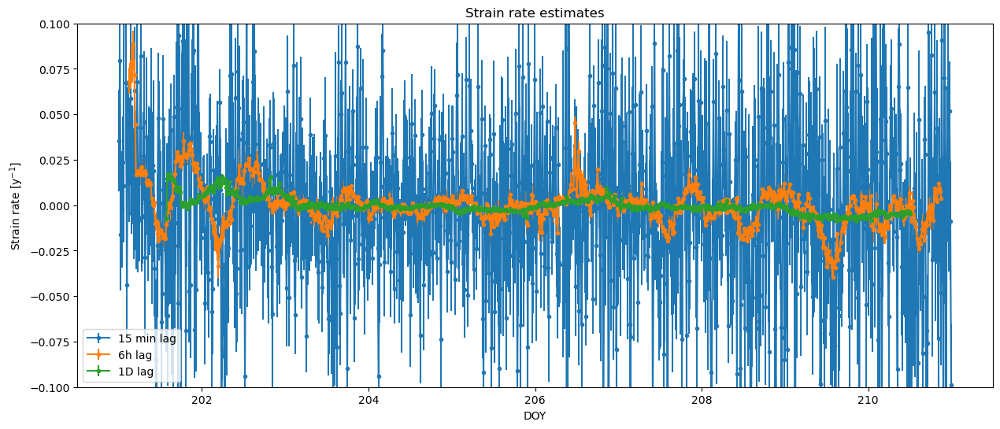

In [11]:
a13_15 = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
a13_6h = strain_metrics(interp_profiles_adjust, 24, 24,24,500,1)
a13_1d = strain_metrics(interp_profiles_adjust, 24, 24,96,500,1)


plot_fits([a13_15,a13_6h,a13_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.1,0.1])

In [13]:
# Load data
with open('../chirp_processing/A13_22S.pickle', 'rb') as handle:
    s22 = pickle.load(handle)

with open('../chirp_processing/A13_22W.pickle', 'rb') as handle:
    winter = pickle.load(handle)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


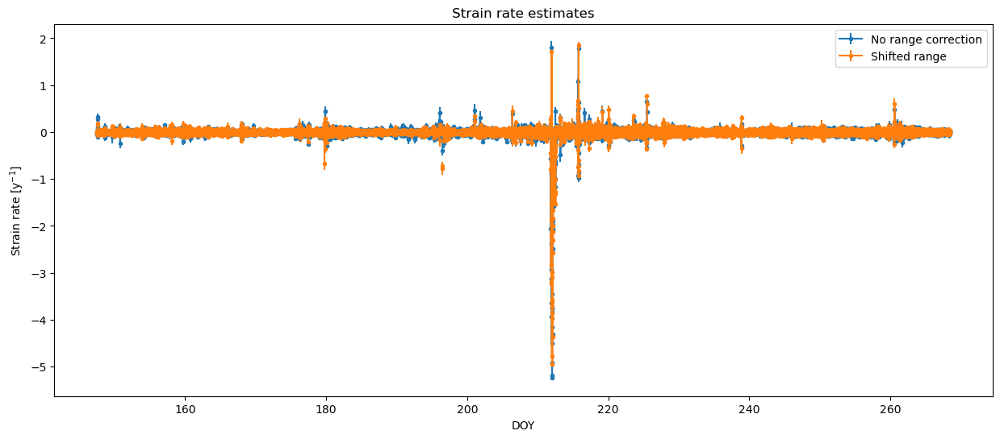

In [14]:
# all summer
time_to_interp = pd.date_range("2022-05-27 12:00", "2022-09-25 12:00", freq="15min")
interp_profiles = s22.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,25)

a13 = strain_metrics(interp_profiles, 24, 24,1,500)
a13_adjust = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
plot_fits([a13,a13_adjust],['No range correction','Shifted range'],doy=True)
#plt.xlim([240,245])

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.1, 0.1)

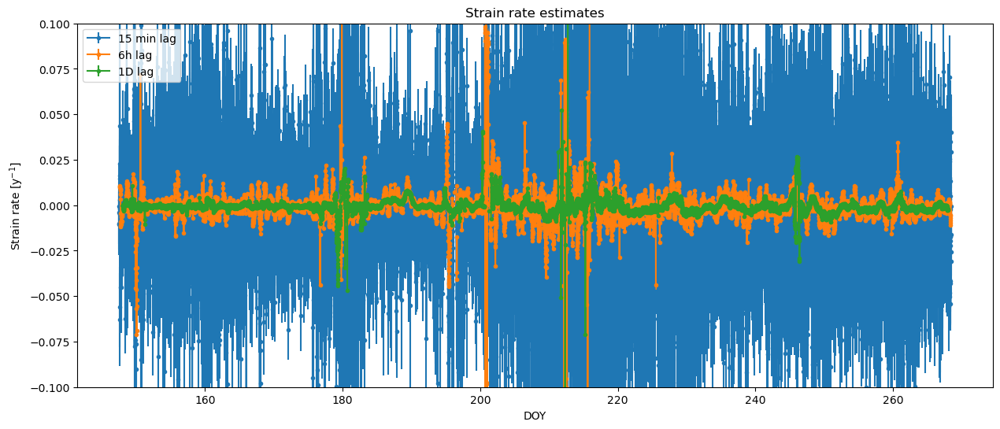

In [15]:
a13_15 = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
a13_6h = strain_metrics(interp_profiles_adjust, 24, 24,24,500,1)
a13_1d = strain_metrics(interp_profiles_adjust, 24, 24,96,500,1)


plot_fits([a13_15,a13_6h,a13_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.1,0.1])

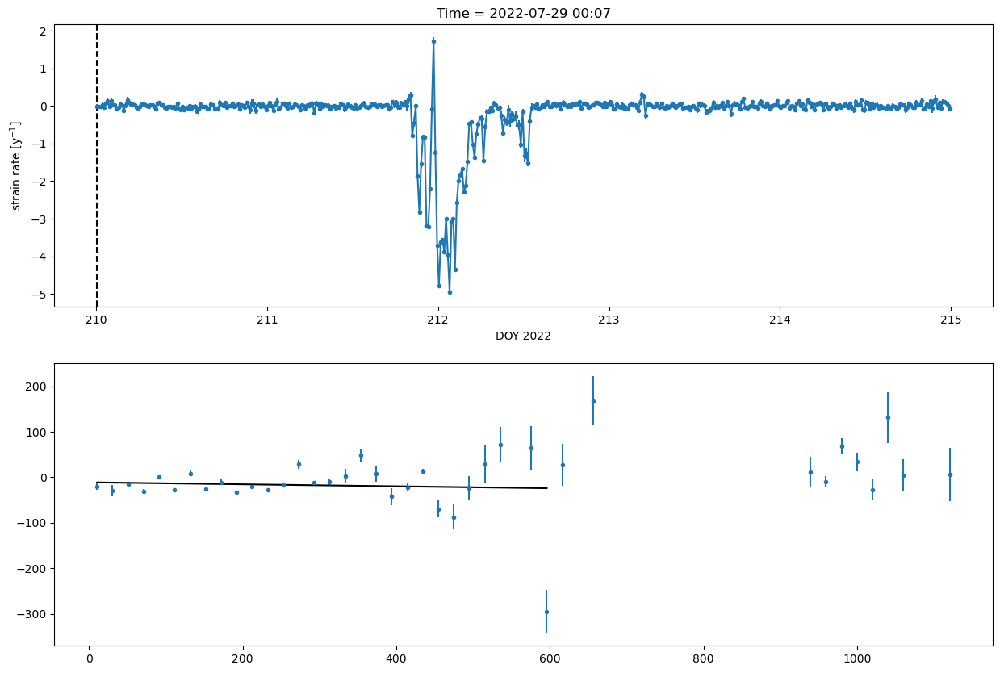

In [18]:
ani = animate_vv(a13_adjust.where(a13_adjust.doy_decimal > 210,drop = True).where(a13_adjust.doy_decimal < 215,drop=True))
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


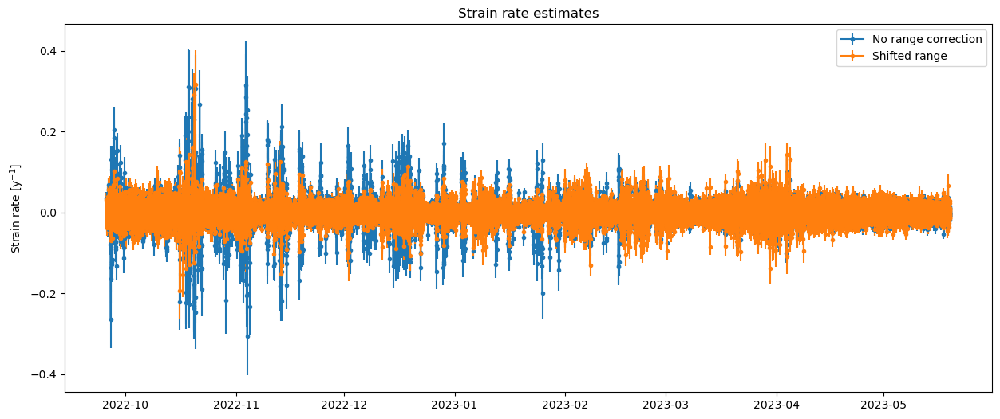

In [16]:
# all winter
time_to_interp = pd.date_range("2022-09-25 16:00", "2023-05-22 12:00", freq="15min")
interp_profiles = winter.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,25)

a13 = strain_metrics(interp_profiles, 24, 24,1,500)
a13_adjust = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
plot_fits([a13,a13_adjust],['No range correction','Shifted range'])
#plt.xlim([240,245])

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.01, 0.01)

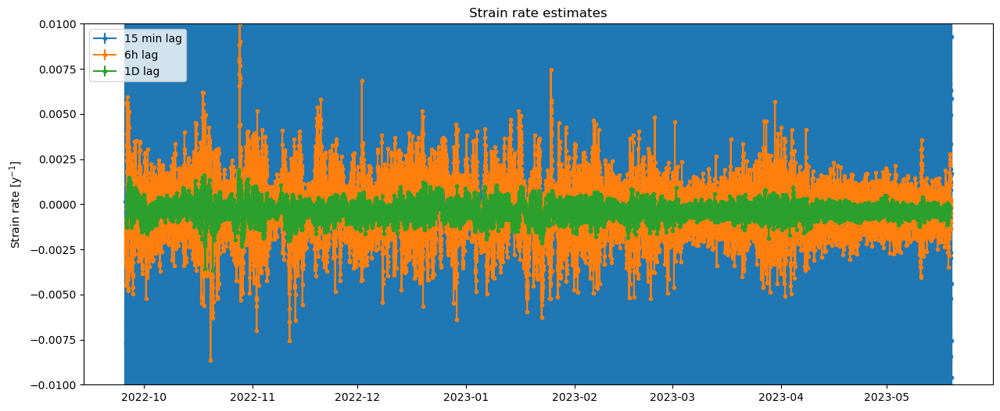

In [18]:
a13_15 = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
a13_6h = strain_metrics(interp_profiles_adjust, 24, 24,24,500,1)
a13_1d = strain_metrics(interp_profiles_adjust, 24, 24,96,500,1)


plot_fits([a13_15,a13_6h,a13_1d],['15 min lag','6h lag','1D lag'])
plt.ylim([-0.01,0.01])

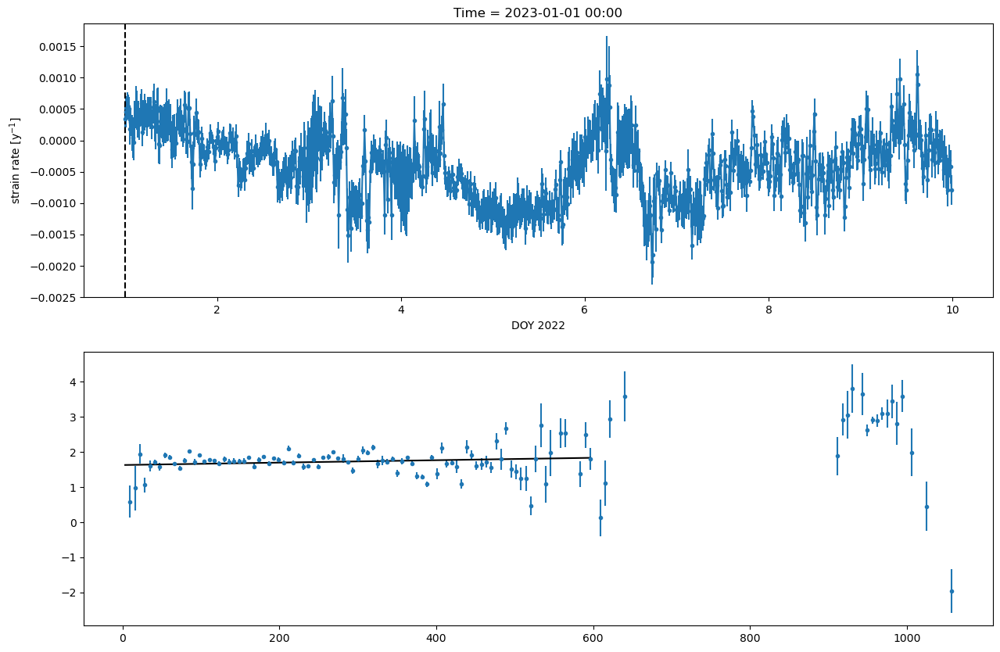

In [19]:
ani = animate_vv(a13_1d.where(a13_1d.doy_decimal > 0,drop = True).where(a13_1d.doy_decimal < 10,drop=True))
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

## A14

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


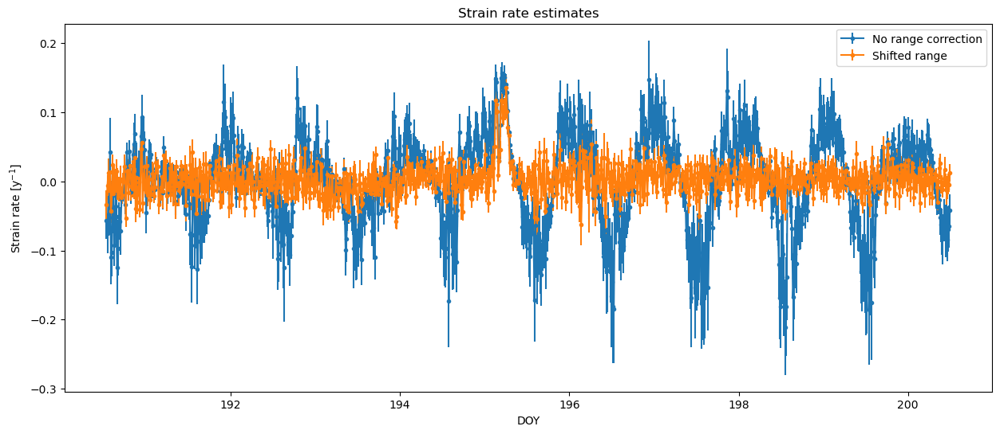

In [21]:
ds_14_drain = ds_14.isel(time=range(4200,5200))
test = custom_profile(ds_14_drain.isel(attenuator_setting_pair=0).chirp,clip_threshold=1.2,min_chirps = 5,start=4000)
time_to_interp = pd.date_range("2022-07-09 12:00", "2022-07-19 12:00", freq="15min")
interp_profiles = test.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)
a14 = strain_metrics(interp_profiles, 80, 80,1,500)
a14_adjust = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
plot_fits([a14,a14_adjust],['No range correction','Shifted range'],doy=True)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.1, 0.1)

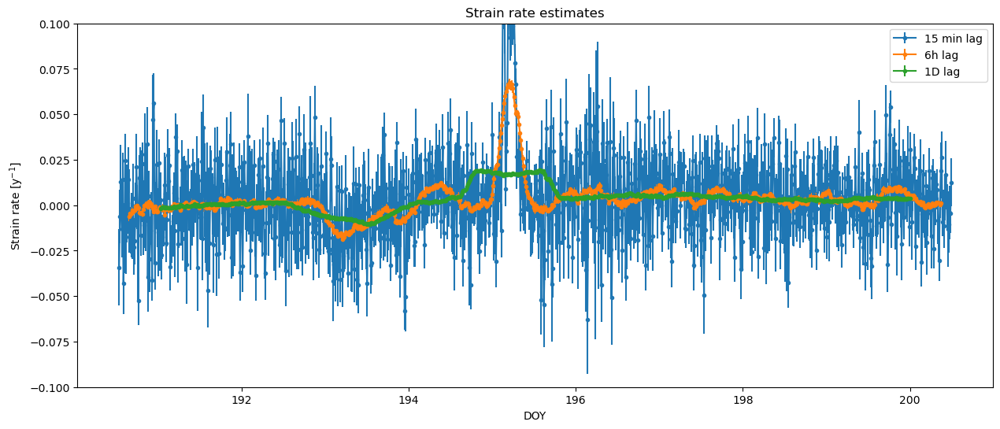

In [23]:
a14_15 = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
a14_6h = strain_metrics(interp_profiles_adjust, 80, 80,24,500,2)
a14_1d = strain_metrics(interp_profiles_adjust, 80, 80,96,500,2)


plot_fits([a14_15,a14_6h,a14_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.1,0.1])

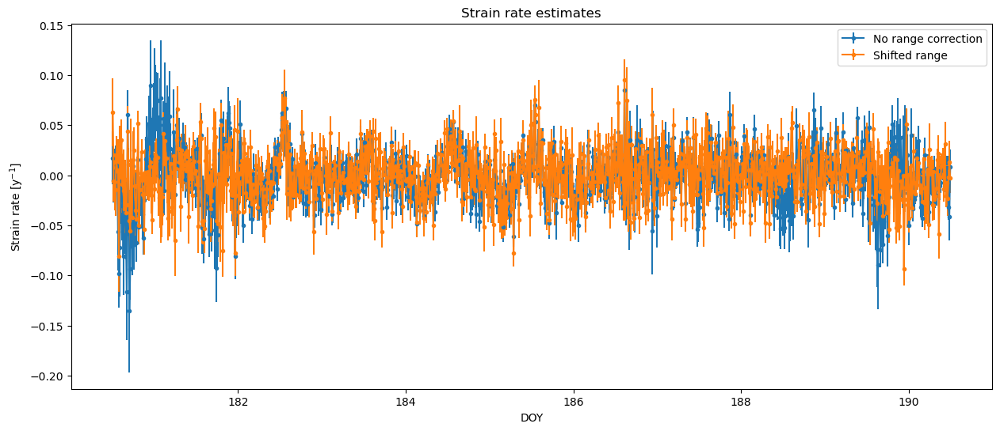

In [24]:
# before
ds_14_drain = ds_14.isel(time=range(3200,4200))
test = custom_profile(ds_14_drain.isel(attenuator_setting_pair=0).chirp,clip_threshold=1.2,min_chirps = 5,start=4000)
time_to_interp = pd.date_range("2022-06-29 12:00", "2022-07-09 12:00", freq="15min")
interp_profiles = test.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)
a14 = strain_metrics(interp_profiles, 80, 80,1,500)
a14_adjust = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
plot_fits([a14,a14_adjust],['No range correction','Shifted range'],doy=True)

(-0.1, 0.1)

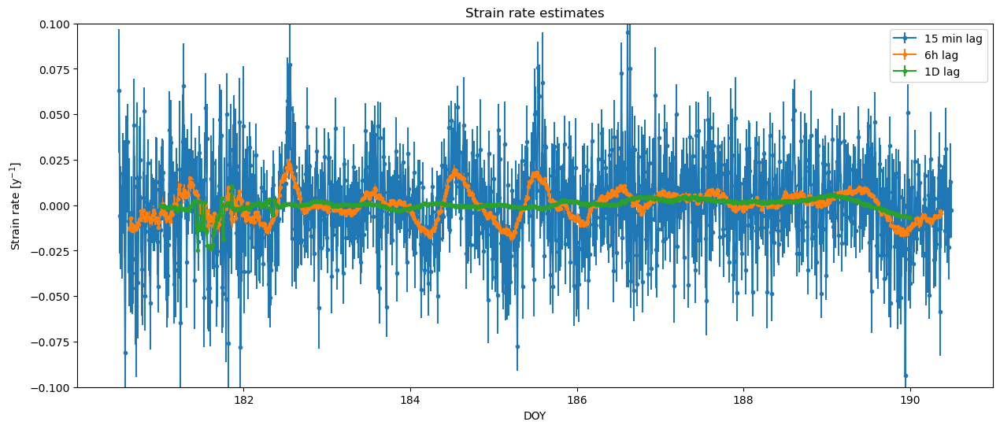

In [25]:
a14_15 = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
a14_6h = strain_metrics(interp_profiles_adjust, 80, 80,24,500,2)
a14_1d = strain_metrics(interp_profiles_adjust, 80, 80,96,500,2)


plot_fits([a14_15,a14_6h,a14_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.1,0.1])

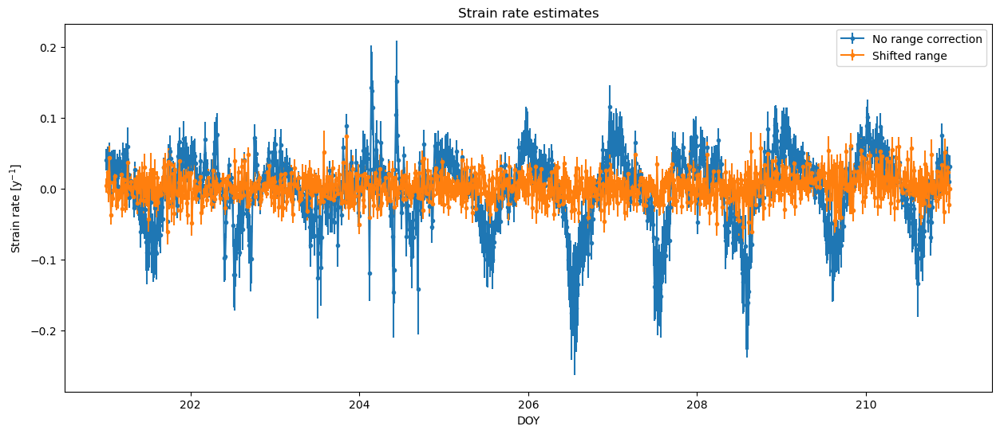

In [26]:
# after
ds_14_drain = ds_14.isel(time=range(5200,6200))
test = custom_profile(ds_14_drain.isel(attenuator_setting_pair=0).chirp,clip_threshold=1.2,min_chirps = 5,start=4000)
time_to_interp = pd.date_range("2022-07-20 0:00", "2022-07-30 0:00", freq="15min")
interp_profiles = test.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)
a14 = strain_metrics(interp_profiles, 80, 80,1,500)
a14_adjust = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
plot_fits([a14,a14_adjust],['No range correction','Shifted range'],doy=True)

(-0.1, 0.1)

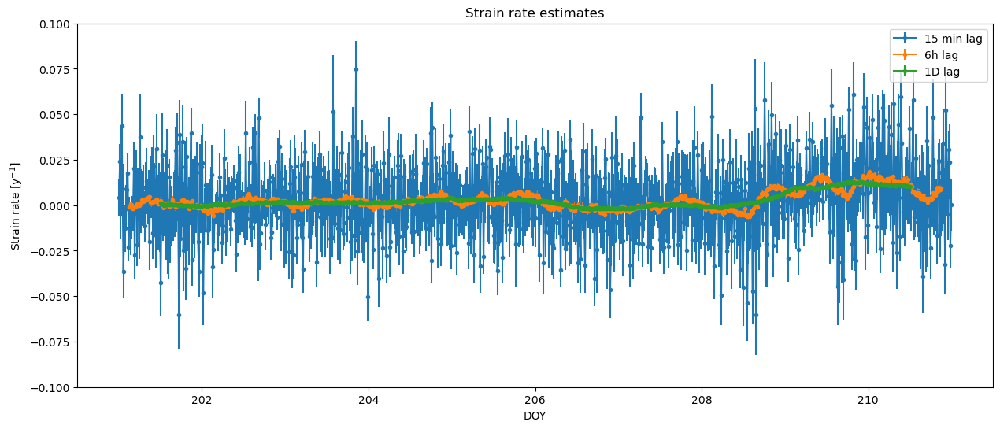

In [27]:
a14_15 = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
a14_6h = strain_metrics(interp_profiles_adjust, 80, 80,24,500,2)
a14_1d = strain_metrics(interp_profiles_adjust, 80, 80,96,500,2)


plot_fits([a14_15,a14_6h,a14_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.1,0.1])

In [28]:
# Load data
with open('../chirp_processing/A14_22S.pickle', 'rb') as handle:
    s22 = pickle.load(handle)

with open('../chirp_processing/A14_22W.pickle', 'rb') as handle:
    winter = pickle.load(handle)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


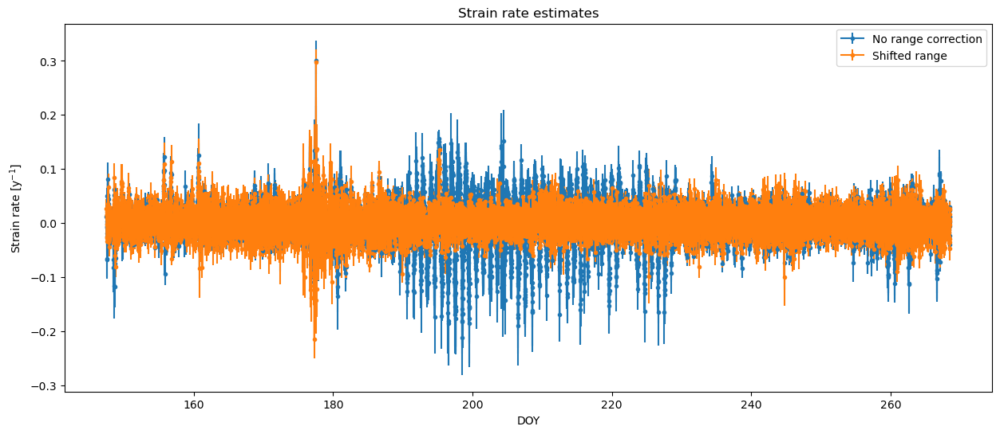

In [29]:
# all summer
time_to_interp = pd.date_range("2022-05-27 12:00", "2022-09-25 12:00", freq="15min")
interp_profiles = s22.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

a14 = strain_metrics(interp_profiles, 80, 80,1,500)
a14_adjust = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
plot_fits([a14,a14_adjust],['No range correction','Shifted range'],doy=True)
#plt.xlim([240,245])

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.1, 0.1)

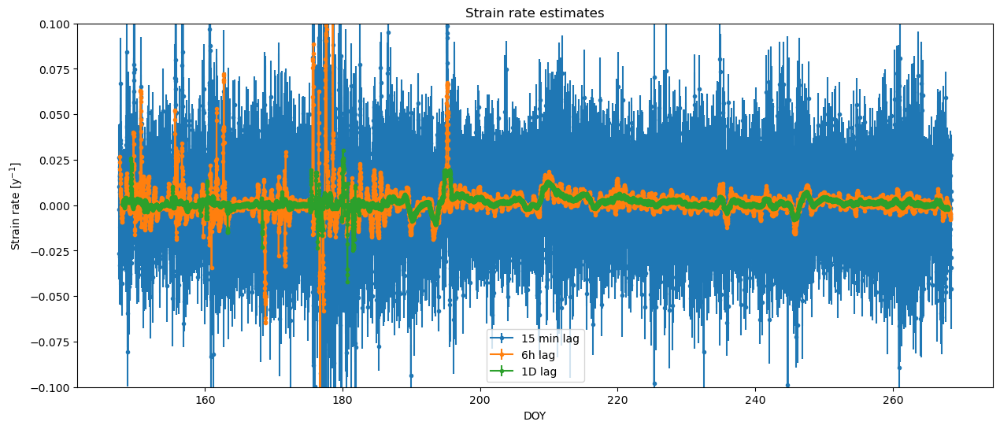

In [30]:
a14_15 = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
a14_6h = strain_metrics(interp_profiles_adjust, 80, 80,24,500,2)
a14_1d = strain_metrics(interp_profiles_adjust, 80, 80,96,500,2)


plot_fits([a14_15,a14_6h,a14_1d],['15 min lag','6h lag','1D lag'],doy=True)
plt.ylim([-0.1,0.1])

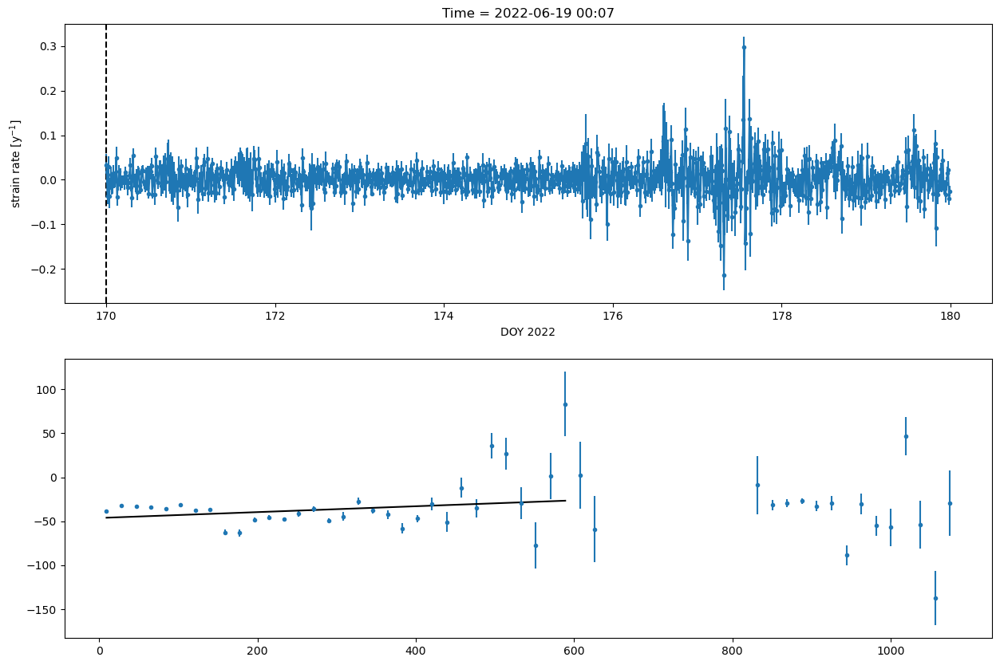

In [25]:
ani = animate_vv(a14_adjust.where(a14_adjust.doy_decimal > 170,drop = True).where(a14_adjust.doy_decimal < 180,drop=True))
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


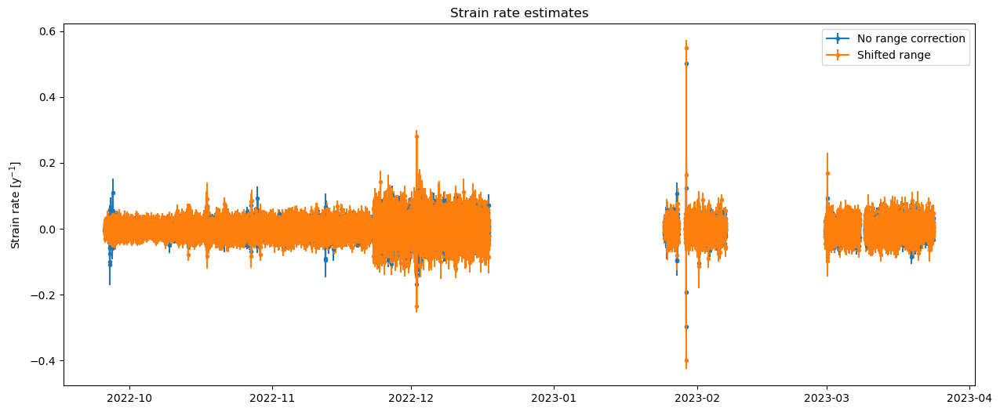

In [31]:
# all winter
time_to_interp = pd.date_range("2022-09-25 16:00", "2023-05-22 12:00", freq="15min")
interp_profiles = winter.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

a14 = strain_metrics(interp_profiles, 80, 80,1,500)
a14_adjust = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
plot_fits([a14,a14_adjust],['No range correction','Shifted range'])
#plt.xlim([240,245])

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.1, 0.1)

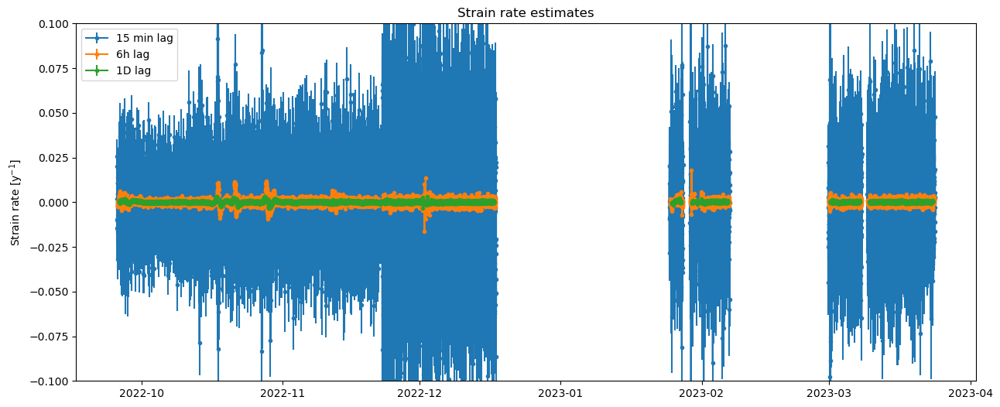

In [32]:
a14_15 = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
a14_6h = strain_metrics(interp_profiles_adjust, 80, 80,24,500,2)
a14_1d = strain_metrics(interp_profiles_adjust, 80, 80,96,500,2)


plot_fits([a14_15,a14_6h,a14_1d],['15 min lag','6h lag','1D lag'])
plt.ylim([-0.1,0.1])